# DATA

# Imports

In [1]:
# Standard libraries

import datetime
import sys                                    # Required to import my libraries.

# Third-party libraries

from IPython.display import display           # display(df) prints large DataFrames in nice table format.
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

# My libraries

sys.path.insert(0, "../src")
from bikesharing import get_datetime_from_df_data_row

# Global Variables

In [2]:
file_data = "../data/hour.csv"

# Input Data

In [3]:
df_data = pd.read_csv(file_data)
display(df_data)

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0000,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0000,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0000,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0000,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0000,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17374,17375,2012-12-31,1,1,12,19,0,1,1,2,0.26,0.2576,0.60,0.1642,11,108,119
17375,17376,2012-12-31,1,1,12,20,0,1,1,2,0.26,0.2576,0.60,0.1642,8,81,89
17376,17377,2012-12-31,1,1,12,21,0,1,1,1,0.26,0.2576,0.60,0.1642,7,83,90
17377,17378,2012-12-31,1,1,12,22,0,1,1,1,0.26,0.2727,0.56,0.1343,13,48,61


# Data Exploration

### Features

In [4]:
# DataFrame column names, count & type.
df_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17379 entries, 0 to 17378
Data columns (total 17 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   instant     17379 non-null  int64  
 1   dteday      17379 non-null  object 
 2   season      17379 non-null  int64  
 3   yr          17379 non-null  int64  
 4   mnth        17379 non-null  int64  
 5   hr          17379 non-null  int64  
 6   holiday     17379 non-null  int64  
 7   weekday     17379 non-null  int64  
 8   workingday  17379 non-null  int64  
 9   weathersit  17379 non-null  int64  
 10  temp        17379 non-null  float64
 11  atemp       17379 non-null  float64
 12  hum         17379 non-null  float64
 13  windspeed   17379 non-null  float64
 14  casual      17379 non-null  int64  
 15  registered  17379 non-null  int64  
 16  cnt         17379 non-null  int64  
dtypes: float64(4), int64(12), object(1)
memory usage: 2.3+ MB


In [5]:
# Print numerical features statistics
df_data.describe()

,instant,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
count,17379.0000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000
mean,8690.0000,2.501640,0.502561,6.537775,11.546752,0.028770,3.003683,0.682721,1.425283,0.496987,0.475775,0.627229,0.190098,35.676218,153.786869,189.463088
std,5017.0295,1.106918,0.500008,3.438776,6.914405,0.167165,2.005771,0.465431,0.639357,0.192556,0.171850,0.192930,0.122340,49.305030,151.357286,181.387599
min,1.0000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.020000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,4345.5000,2.000000,0.000000,4.000000,6.000000,0.000000,1.000000,0.000000,1.000000,0.340000,0.333300,0.480000,0.104500,4.000000,34.000000,40.000000
50%,8690.0000,3.000000,1.000000,7.000000,12.000000,0.000000,3.000000,1.000000,1.000000,0.500000,0.484800,0.630000,0.194000,17.000000,115.000000,142.000000
75%,13034.5000,3.000000,1.000000,10.000000,18.000000,0.000000,5.000000,1.000000,2.000000,0.660000,0.621200,0.780000,0.253700,48.000000,220.000000,281.000000
max,17379.0000,4.000000,1.000000,12.000000,23.000000,1.000000,6.000000,1.000000,4.000000,1.000000,1.000000,1.000000,0.850700,367.000000,886.000000,977.000000


In [6]:
# Print unique values of each feature

def print_df_unique_values(df: pd.DataFrame) -> None:
    """Print unique values for each column of a DataFrame."""

    for col in df.columns:
        
        s = df[col]
    
        # Column name
    
        print()
        print("--------------------------------------------------")
        print()
        print("COLUMN NAME")
        print()
        print(s.name)
        
        # Unique values
        
        print()
        print("UNIQUE VALUES")
        print()
        uniques = s.unique()
        uniques = np.sort(uniques)
        print()
        print(uniques)
        
        # Unique values count
        
        print()
        print("UNIQUE VALUES COUNT")
        print()
        print(s.value_counts().sort_index())

print_df_unique_values(df_data)



--------------------------------------------------

COLUMN NAME

instant

UNIQUE VALUES


[    1     2     3 ... 17377 17378 17379]

UNIQUE VALUES COUNT

1        1
2        1
3        1
4        1
5        1
        ..
17375    1
17376    1
17377    1
17378    1
17379    1
Name: instant, Length: 17379, dtype: int64

--------------------------------------------------

COLUMN NAME

dteday

UNIQUE VALUES


['2011-01-01' '2011-01-02' '2011-01-03' '2011-01-04' '2011-01-05'
 '2011-01-06' '2011-01-07' '2011-01-08' '2011-01-09' '2011-01-10'
 '2011-01-11' '2011-01-12' '2011-01-13' '2011-01-14' '2011-01-15'
 '2011-01-16' '2011-01-17' '2011-01-18' '2011-01-19' '2011-01-20'
 '2011-01-21' '2011-01-22' '2011-01-23' '2011-01-24' '2011-01-25'
 '2011-01-26' '2011-01-27' '2011-01-28' '2011-01-29' '2011-01-30'
 '2011-01-31' '2011-02-01' '2011-02-02' '2011-02-03' '2011-02-04'
 '2011-02-05' '2011-02-06' '2011-02-07' '2011-02-08' '2011-02-09'
 '2011-02-10' '2011-02-11' '2011-02-12' '2011-02-13' '2011-02-1

### Feature Distributions

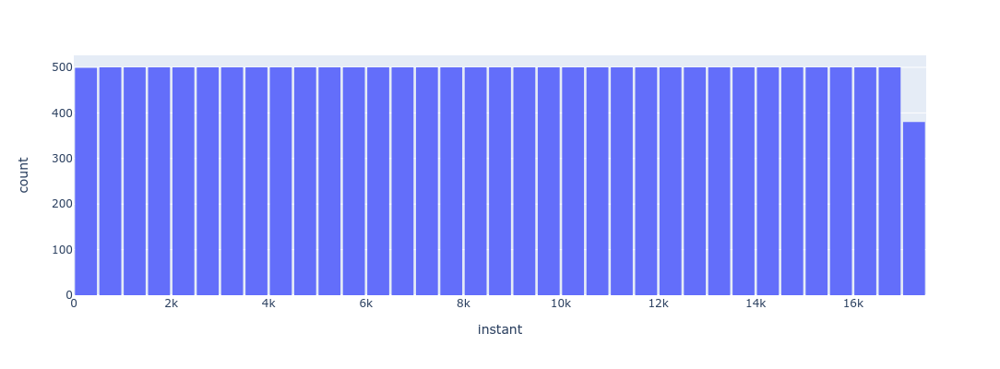

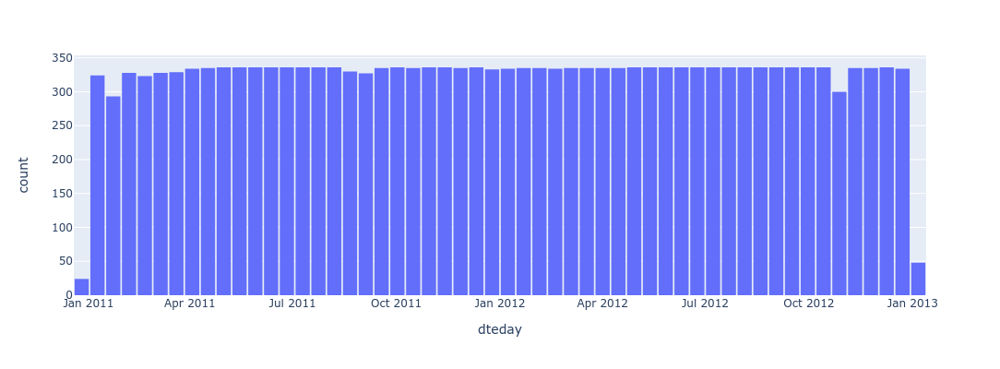

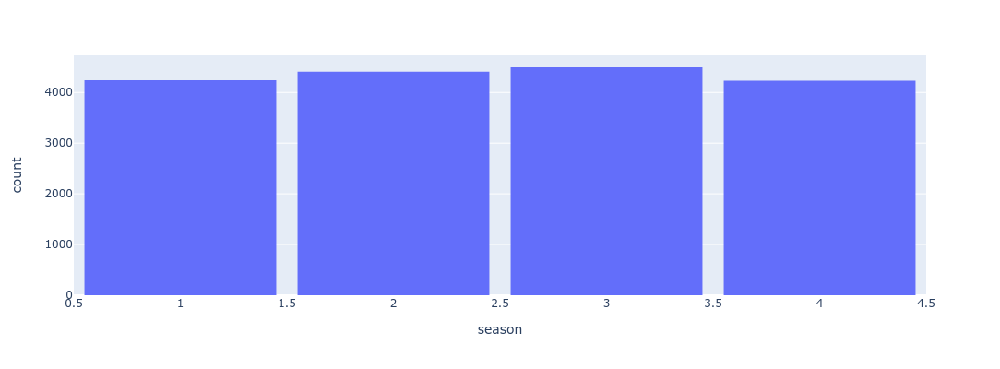

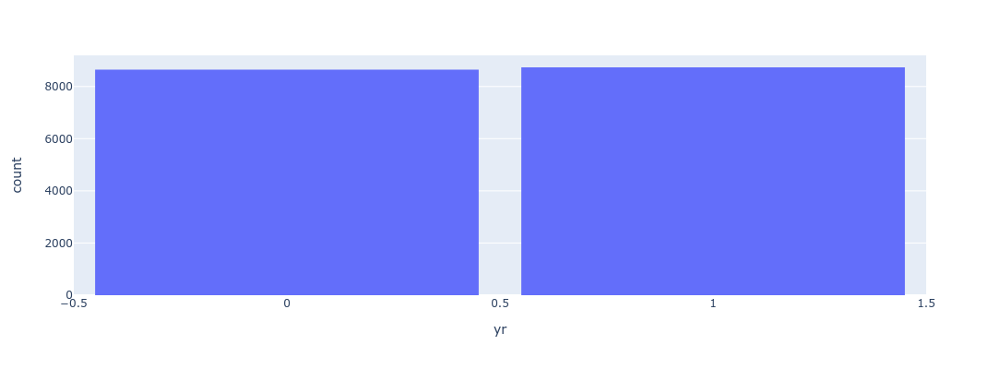

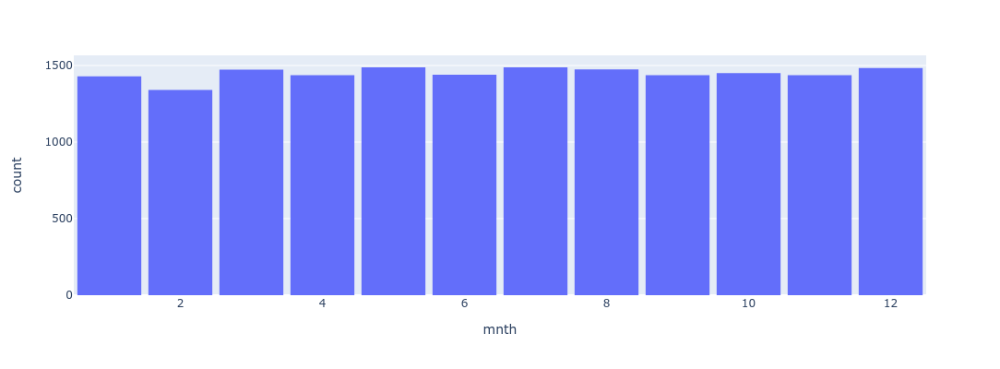

...

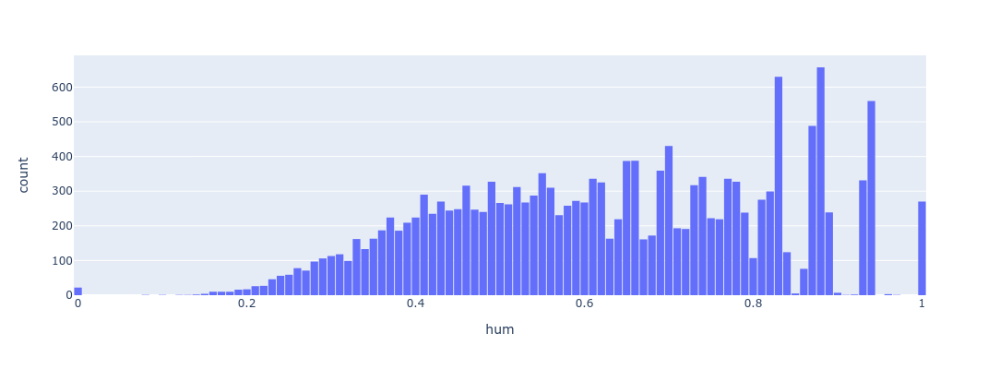

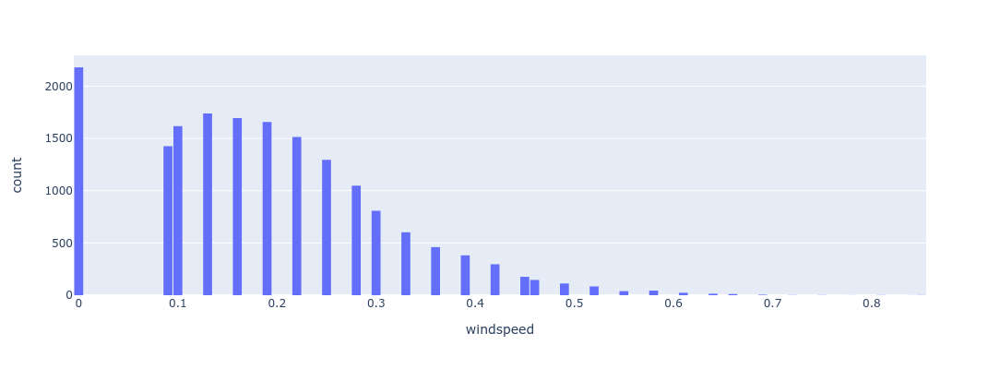

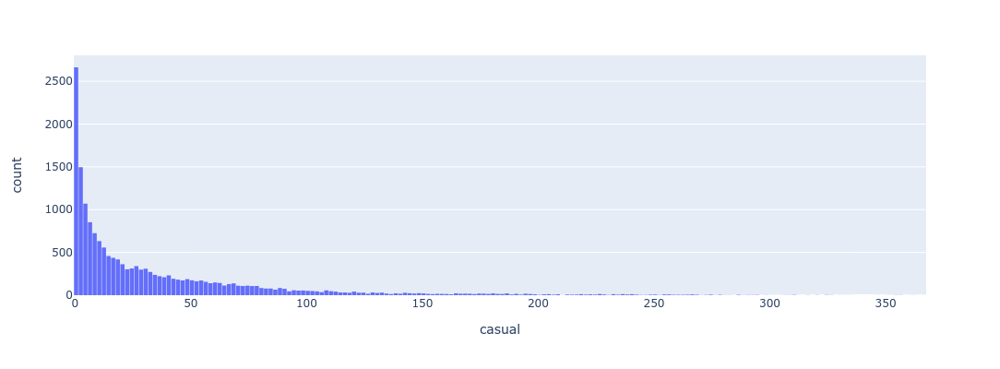

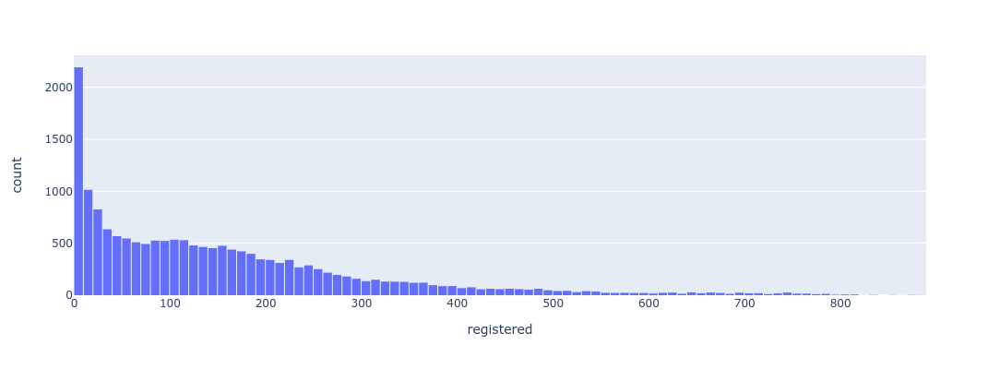

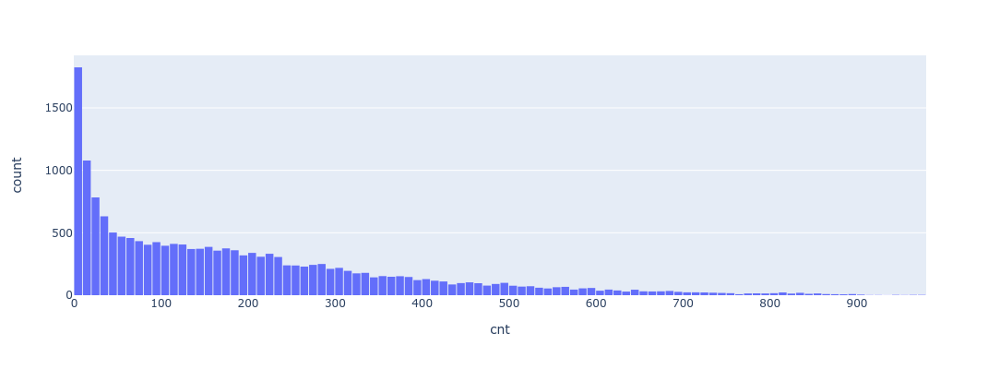

In [7]:
def plot_df_histograms(df: pd.DataFrame) -> None:
    """Plot histograms for each column of a DataFrame."""

    for col in df.columns:
        
        s = df[col]
        
        # Print histogram
        
        print()
        fig = px.histogram(x=s)
        fig.layout.xaxis.title = s.name
        fig.layout.height= 400
        fig.layout.width = 800
        fig.layout.bargap = 0.1
        fig.show()

plot_df_histograms(df_data)


### Feature Time Series

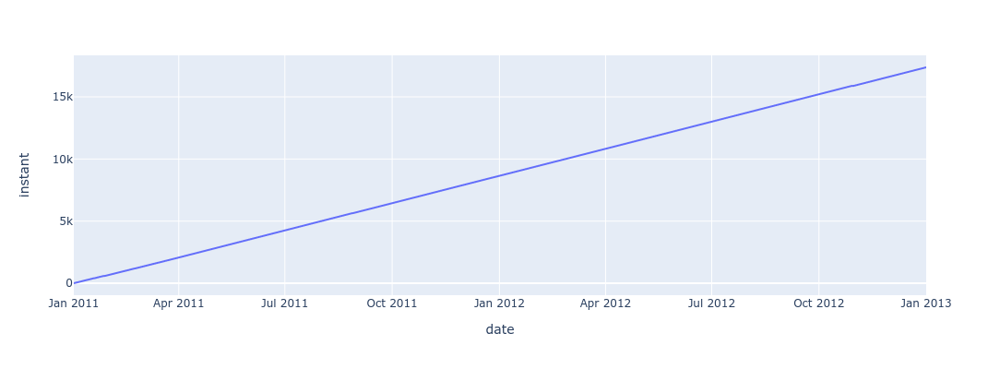

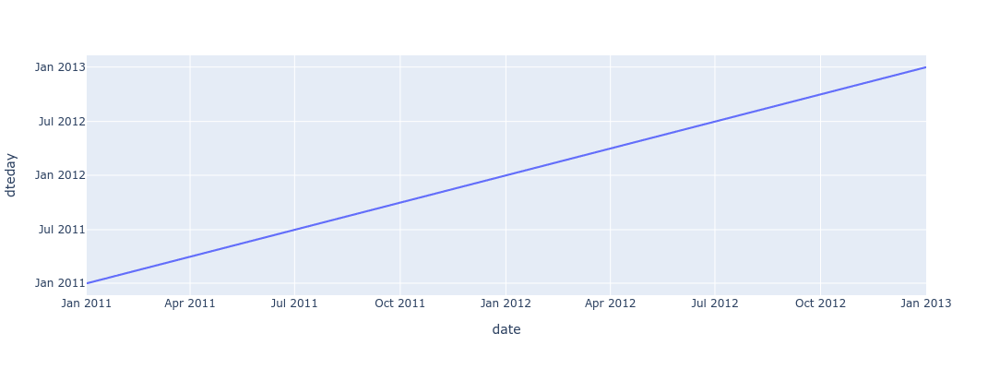

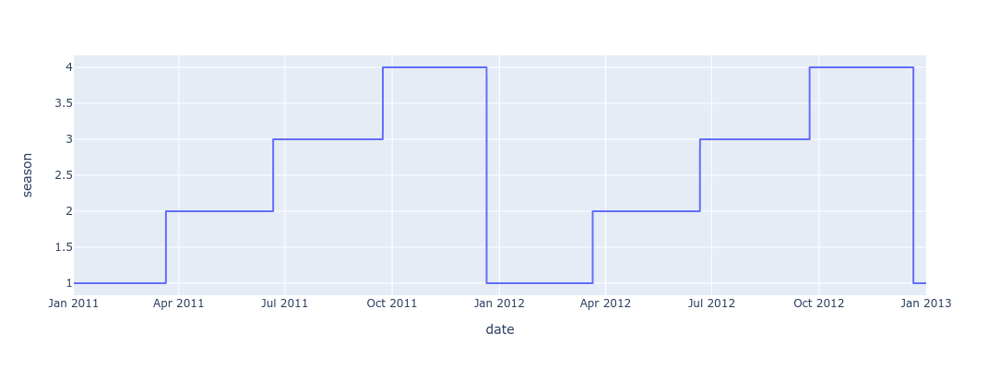

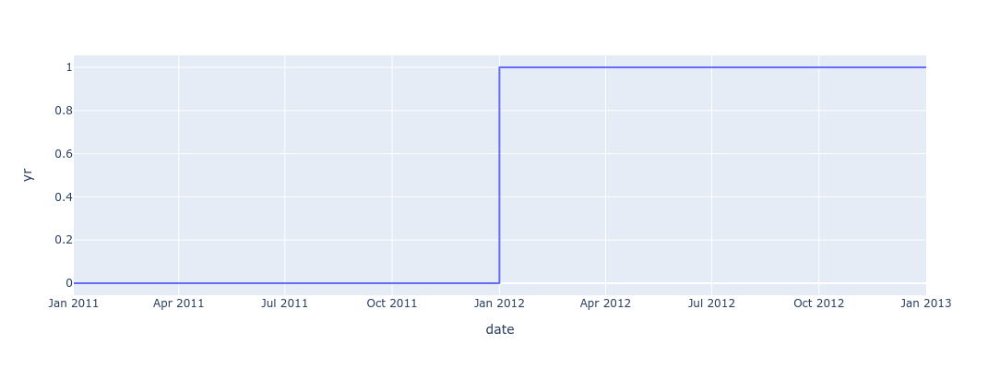

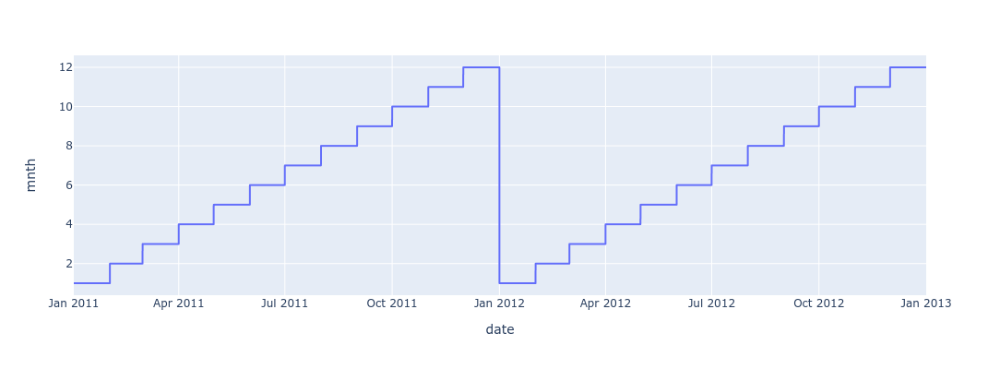

...

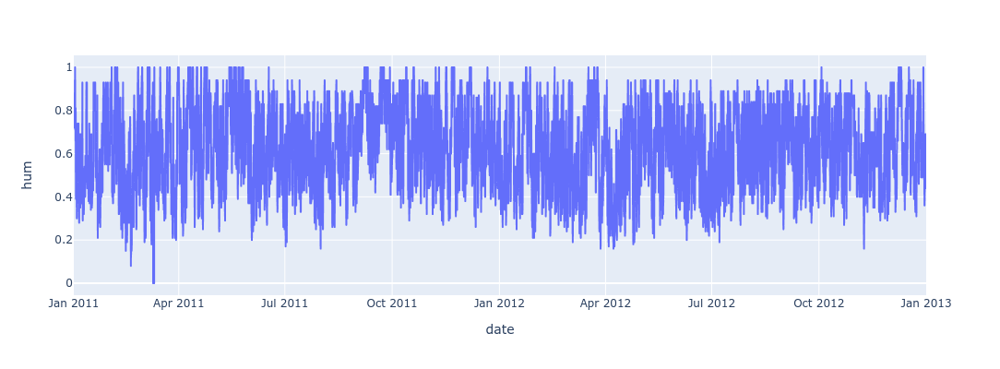

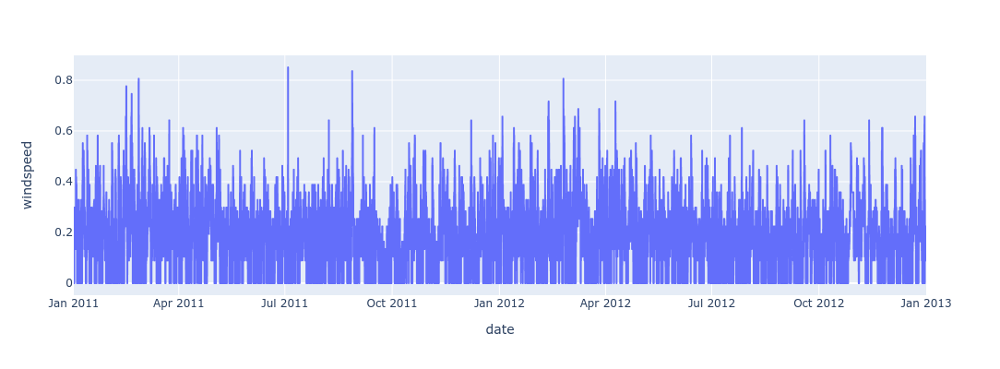

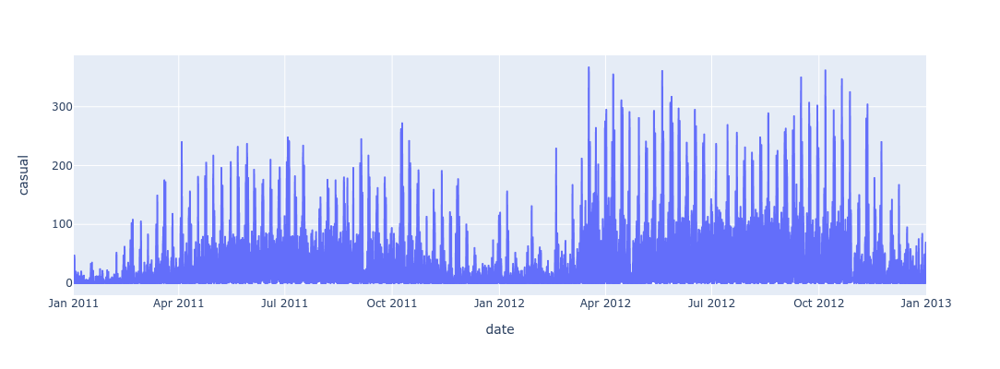

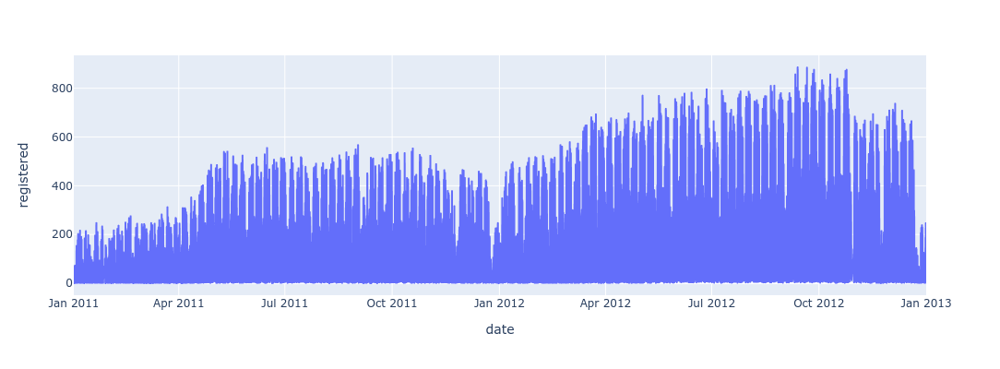

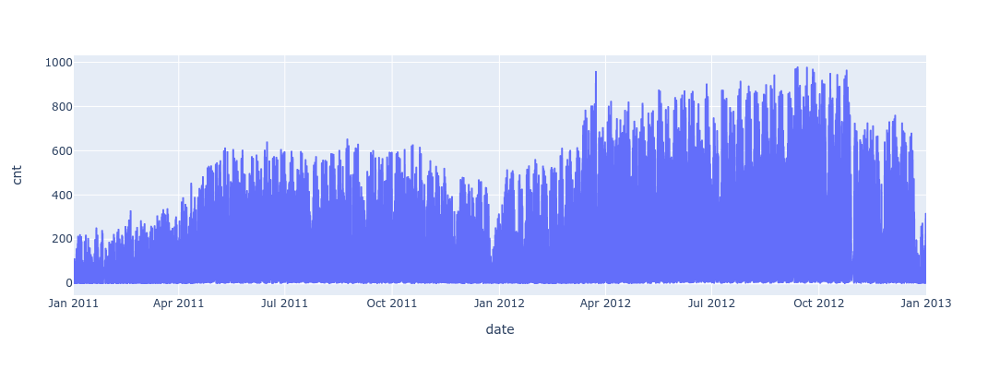

In [8]:
def plot_df_time_series(df: pd.DataFrame, t: pd.Series) -> None:
    """Plot line chart for each column of a DataFrame wrt a time series."""    

    for col in df.columns:
        
        s = df[col]
        
        # Print line chart
        
        print()
        fig = px.line(x=t.values, y=s.values)
        fig.layout.xaxis.title = t.name
        fig.layout.yaxis.title = s.name
        fig.layout.height= 400
        fig.layout.width = 800
        fig.show()

        
s = df_data.apply(lambda x: get_datetime_from_df_data_row(x), axis=1)
s.name = "date"
        
plot_df_time_series(df_data, s)


### Missing Values

In [9]:
df_data.isna().sum()

instant       0
dteday        0
season        0
yr            0
mnth          0
hr            0
holiday       0
weekday       0
workingday    0
weathersit    0
temp          0
atemp         0
hum           0
windspeed     0
casual        0
registered    0
cnt           0
dtype: int64